<a href="https://colab.research.google.com/github/edcalderin/BreastCancerDetection_CNN/blob/master/cnn_breast.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# WomanLife

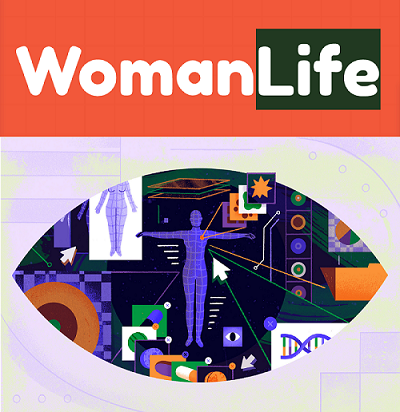


Proyecto final en SaturdaysAI La Paz, para la detección y clasificación de cáncer de mama en mujeres de 25 a 75 años de edad a partir de imágenes de ultrasonido.

Agradacimiento a los autores del sitio web por proveer una fuente de imágenes abiertas para propósitos de investigación: 

https://scholar.cu.edu.eg/?q=afahmy/pages/dataset


*   Al-Dhabyani W, Gomaa M, Khaled H, Fahmy A. Dataset of breast ultrasound images. Data in Brief. 2020 Feb;28:104863. DOI: 10.1016/j.dib.2019.104863.

## Modulos

In [ ]:
# Módulos de Tensorflow
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.utils import plot_model
tf.config.run_functions_eagerly(True)
print(tf.__version__)

# Tensorboard
from tensorflow.keras.callbacks import TensorBoard
from tensorboard import notebook

# Deployment
from tensorflow import lite

2.5.0


In [ ]:
!pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-5f8piyru
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-5f8piyru


In [ ]:
# Utilidades
import matplotlib.pyplot as plt
import numpy as np
import time
from IPython import display
import PIL
import os
import imageio
import glob
import tensorflow_docs.vis.embed as embed

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
print(tf.config.get_visible_devices())

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## Lectura de datos

Si utilizas las imagenes desde la fuente de datos orignal, entonces ejecuta las siguientes instrucciones:  
* Borrar imágenes de máscaras que no aportan información significativa al modelo. Para ello debes ejectuar las sentencias Shell comentadas e ir
cambiando el nombre del directorio al final de la ruta para acceder a las otras clasificaciones.

In [ ]:
#%cd '/content/drive/SaturdaysAI/Dataset_BUSI_with_GT/normal/'
#%rm *mask*.png

# Deben existir 437, 210 y 133 imagenes en los directorios benign, malignant y normal, respectivamente para un total de 780 imágenes

**VARIABLES DE CONFIGURACIÓN GLOBAL:**

In [ ]:
############################
BATCH_SIZE = 64
IMG_WIDTH = 224
IMG_HEIGHT = 224
SEED = 1234
EPOCHS = 25
LEARNING_RATE = 0.00008
INPUT_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 1)
############################

Datos para Train y Test:

In [ ]:
# Directorio
PATH = '/content/drive/MyDrive/SaturdaysAI'

# Parametros reutilizables
PARAMS = dict(directory = PATH+'/Dataset_BUSI_with_GT', 
              seed = SEED, 
              label_mode='int',              
              validation_split = 0.2,
              batch_size = BATCH_SIZE, 
              image_size = (IMG_WIDTH, IMG_HEIGHT), 
              color_mode = 'grayscale')

train_img = keras.preprocessing.image_dataset_from_directory(**PARAMS, subset='training')
test_img = keras.preprocessing.image_dataset_from_directory(**PARAMS, subset='validation')

Found 780 files belonging to 3 classes.
Using 624 files for training.


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:3704: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


Found 780 files belonging to 3 classes.
Using 156 files for validation.


In [ ]:
class_names = train_img.class_names
print(class_names)

['benign', 'malignant', 'normal']


Separando imagenes en categorías a partir de los tensores obtenidos:

In [ ]:
%%time
normal, benign, malignant = [], [], []
for img_batch, label_batch in train_img:
  for img, label in zip(img_batch, label_batch):
    if label == 0:
      benign.append(img)
    elif label==1:
      malignant.append(img)
    else:
      if label==2:
        normal.append(img)

CPU times: user 6.12 s, sys: 353 ms, total: 6.47 s
Wall time: 4.04 s


In [ ]:
# Igual a 624 imágenes de entrenamiento
assert(len(normal)+len(benign)+len(malignant)) == 624

In [ ]:
%%time
images, labels = next(iter(train_img))

CPU times: user 5.46 s, sys: 271 ms, total: 5.73 s
Wall time: 5.12 s


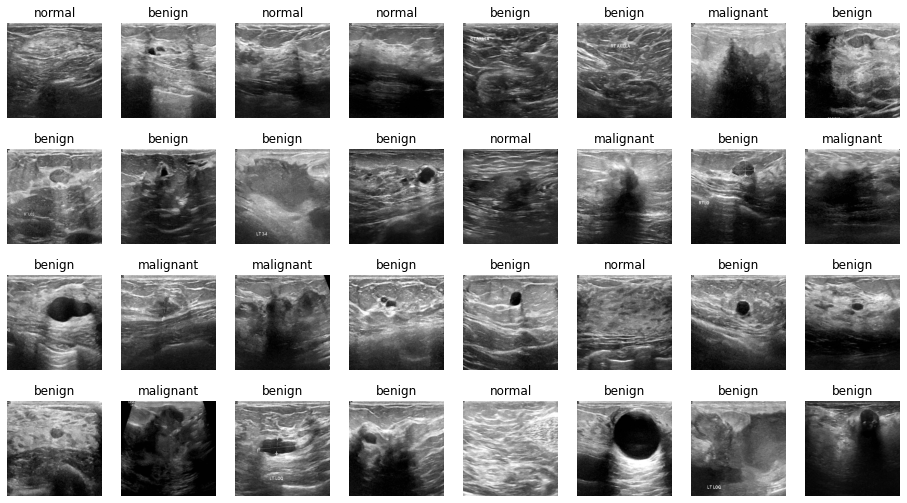

In [ ]:
fig = plt.figure(figsize=(16, 10))
axes = fig.subplots(4, 8)
fig.subplots_adjust(bottom=0, top=.7, hspace=0, wspace=0.2)
for ax, image, label in zip(axes.flatten(), images, labels.numpy()):
    ax.set_title(class_names[label])
    ax.imshow(np.squeeze(image), cmap='gray')
    ax.axis('off')

## Data Augmentation: GAN 

Se presentan escasos datos para entrenamiento por lo cual se empleará Data Augmentation para generar nuevas imágenes, tratándose de imágenes médicas no se recomienda usar método tradicional (rotación, zoom, recortes...) sino a través de una Red Advsaria Generativa (GAN) que nos ayudará a crear imágenes realistas.

### Generador

Configuración:

In [ ]:
LR_GAN = 0.00008
BATCH_SIZE_GAN = 28
EPOCHS_GAN = 70
NOISE_DIM = 200

In [ ]:
class Generator(keras.Model):      
  def __init__(self):
    super().__init__()
    self.dense_1 = layers.Dense(7*7*512)
    self.batchnorm_1 = layers.BatchNormalization()
    self.leakyReLU_1 = layers.LeakyReLU()
    self.reshape_1 = layers.Reshape((7,7,512))

    self.convTransp_1 = layers.Conv2DTranspose(512, strides=(2,2), **self.getCommonParams())    
    self.batchnorm_2 = layers.BatchNormalization()
    self.leakyReLU_2 = layers.LeakyReLU()

    self.convTransp_2 = layers.Conv2DTranspose(256, strides=(2,2), **self.getCommonParams())    
    self.batchnorm_3 = layers.BatchNormalization()
    self.leakyReLU_3 = layers.LeakyReLU()

    self.convTransp_3 = layers.Conv2DTranspose(256, strides=(2,2), **self.getCommonParams())
    self.batchnorm_4 = layers.BatchNormalization()
    self.leakyReLU_4 = layers.LeakyReLU()
    
    self.convTransp_4 = layers.Conv2DTranspose(64, strides=(2,2), **self.getCommonParams())
    self.batchnorm_5 = layers.BatchNormalization()
    self.leakyReLU_5 = layers.LeakyReLU()
    
    self.convTransp_5 = layers.Conv2DTranspose(32, strides=(2,2), **self.getCommonParams())
    self.batchnorm_6 = layers.BatchNormalization()
    self.leakyReLU_6 = layers.LeakyReLU()  

    self.convTransp_6 = layers.Conv2DTranspose(1, strides=(1,1), activation='tanh', **self.getCommonParams())

  def getCommonParams(self):
    return dict(
        kernel_size=(5,5), 
        padding='same', 
        use_bias=False
    )
    
  def call(self, input):
    x = self.dense_1(input)
    x = self.batchnorm_1(x)
    x = self.leakyReLU_1(x)
    x = self.reshape_1(x)

    x = self.convTransp_1(x)
    x = self.batchnorm_2(x)
    x = self.leakyReLU_2(x)

    x = self.convTransp_2(x)
    x = self.batchnorm_3(x)
    x = self.leakyReLU_3(x)

    x = self.convTransp_3(x)
    x = self.batchnorm_4(x)
    x = self.leakyReLU_4(x)

    x = self.convTransp_4(x)
    x = self.batchnorm_5(x)
    x = self.leakyReLU_5(x) 

    x = self.convTransp_5(x)
    x = self.batchnorm_6(x)
    x = self.leakyReLU_6(x) 

    x = self.convTransp_6(x)
    return x
  
  def generator(self, input_shape=NOISE_DIM):
    x = keras.Input(shape=input_shape)
    x = keras.Model(inputs=[x], outputs= self.call(x))
    return x

In [ ]:
generator_model = Generator()
generator_model.generator().summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 200)]             0         
_________________________________________________________________
dense (Dense)                (None, 25088)             5042688   
_________________________________________________________________
batch_normalization (BatchNo (None, 25088)             100352    
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 25088)             0         
_________________________________________________________________
reshape (Reshape)            (None, 7, 7, 512)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 14, 14, 512)       6553600   
_________________________________________________________________
batch_normalization_1 (Batch (None, 14, 14, 512)       2048  

Visualizando imagen aleatoria a partir de una semilla:

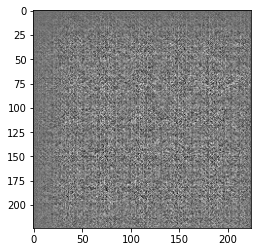

In [ ]:
noise = tf.random.normal([1, NOISE_DIM])
generated_image = generator_model(noise)
plt.imshow(np.squeeze(generated_image), cmap='gray')

### Discriminador

In [ ]:
class Discriminator(keras.Model):

  def __init__(self, num_classes=1):

    super().__init__()    
    
    self.conv_1 = layers.Conv2D(32, **self.getCommonParams())
    self.leakyReLU_1 = layers.LeakyReLU()
    self.dropout_1 = layers.Dropout(0.3)

    self.conv_2 = layers.Conv2D(64, **self.getCommonParams())
    self.leakyReLU_2 = layers.LeakyReLU()
    self.dropout_2 = layers.Dropout(0.3)

    self.conv_3 = layers.Conv2D(128,**self.getCommonParams())
    self.leakyReLU_3 = layers.LeakyReLU()
    self.dropout_3 = layers.Dropout(0.3)

    self.conv_4 = layers.Conv2D(256,**self.getCommonParams())
    self.leakyReLU_4 = layers.LeakyReLU()
    self.dropout_4 = layers.Dropout(0.3)    

    self.conv_5 = layers.Conv2D(512,**self.getCommonParams())
    self.leakyReLU_5 = layers.LeakyReLU()
    self.dropout_5 = layers.Dropout(0.3) 

    self.flatten = layers.Flatten()
    self.dense_1 = layers.Dense(512)
    self.dropout_6 = layers.Dropout(0.1) 
    
    self.dense_2 = layers.Dense(1)

  def getCommonParams(self):
      return dict(
        kernel_size=(5,5), 
        strides=(2,2), 
        padding='same', 
        use_bias=False
      )

  def call(self, input):
    x = self.conv_1(input)
    x = self.leakyReLU_1(x)
    x = self.dropout_1(x)

    x = self.conv_2(x)
    x = self.leakyReLU_2(x)
    x = self.dropout_2(x)

    x = self.conv_3(x)
    x = self.leakyReLU_3(x)
    x = self.dropout_3(x)

    x = self.conv_4(x)
    x = self.leakyReLU_4(x)
    x = self.dropout_4(x)

    x = self.conv_5(x)
    x = self.leakyReLU_5(x)
    x = self.dropout_5(x)

    x = self.flatten(x)
    x = self.dense_1(x)
    x = self.dropout_6(x)

    x = self.dense_2(x)
    return x
  
  def discriminator(self, input_dim=(IMG_WIDTH, IMG_HEIGHT, 1)):
    x = keras.Input(shape=input_dim)
    x = keras.Model(inputs=[x], outputs= self.call(x))
    return x

In [ ]:
discriminator_model = Discriminator()
discriminator_model.discriminator().summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 1)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 112, 112, 32)      800       
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 112, 112, 32)      0         
_________________________________________________________________
dropout (Dropout)            (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 56, 56, 64)        51200     
_________________________________________________________________
leaky_re_lu_7 (LeakyReLU)    (None, 56, 56, 64)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 56, 56, 64)        0   

In [ ]:
discriminator_model(generated_image)

<tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[7.082132e-05]], dtype=float32)>

### Pérdida y optimizadores GAN

In [ ]:
noise = tf.random.normal([20, NOISE_DIM])
cross_entropy = keras.losses.BinaryCrossentropy(from_logits=True)

Pérdida del generador:

In [ ]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

Pérdida del discriminador:

In [ ]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [ ]:
generator_optimizer = tf.optimizers.Adam(LR_GAN)
discriminator_optimizer = tf.optimizers.Adam(LR_GAN)

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(
    generator_optimizer=generator_optimizer,
    discriminator_optimizer=discriminator_optimizer,
    generator=generator_model,
    discriminator=discriminator_model
)

In [ ]:
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator_model(noise, training=True)

      real_output = discriminator_model(images, training=True)
      fake_output = discriminator_model(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)
      gradients_of_generator = gen_tape.gradient(gen_loss, generator_model.trainable_variables)
      gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator_model.trainable_variables)

      generator_optimizer.apply_gradients(zip(gradients_of_generator, generator_model.trainable_variables))
      discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator_model.trainable_variables))
      return gen_loss, disc_loss

In [ ]:
def train(dataset, path_gan, epochs, loss_G, loss_D):
  '''
  dataset: Datos de entrenamiento originales por clas
  path_gan: Directorio en drive donde se almacenarán las imágenes generadas
  epochs: Cantidad de épocas
  '''
  for epoch in range(epochs):
    start = time.time()
    loss_G_loop, loss_D_loop = [], []
    for image_batch in dataset:
      t = train_step(image_batch)
      loss_G_loop.append(t[0])
      loss_D_loop.append(t[1])
    
    loss_g_epoch, loss_d_epoch = get_loss_values(loss_G_loop, loss_D_loop)    
    loss_G.append(loss_g_epoch)
    loss_D.append(loss_d_epoch)

    display.clear_output(wait=True)
    generate_and_save_images(generator_model, epoch + 1, noise)
    if epoch == epochs-1:
        save_to_drive(generator_model, path_gan, noise)
    if (epoch + 1) % 15 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)
      
    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time() - start))

  display.clear_output(wait=True)
  generate_and_save_images(generator_model, epochs, noise)

In [ ]:
def save_to_drive(model, path_dagan, noise):
    predictions = model(noise, training=False)
    for i in range(predictions.shape[0]):
        plt.imsave(f'{path_dagan}/img_{i}.png', predictions[i,:,:,0], cmap='gray')

In [ ]:
def get_loss_values(loss_G_list, loss_D_list):
    loss_g_avg = sum(loss_G_list)/len(loss_G_list)
    loss_d_avg = sum(loss_D_list)/len(loss_D_list)
    return loss_g_avg, loss_d_avg

In [ ]:
def generate_and_save_images(model, epoch, test_input):
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(8, 8))

  for i in range(predictions.shape[0]):
      plt.subplot(4, 5, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
      plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

### Entrenamiento GAN

Eliminando ficheros de alguna compilación anterior:

In [ ]:
!rm image_at_epoch_*.png
!rm -rf training_checkpoints/
!rm dcgan.gif

rm: cannot remove 'image_at_epoch_*.png': No such file or directory
rm: cannot remove 'dcgan.gif': No such file or directory


Conversión a Numpy Array:

In [ ]:
normal_arr = np.array(normal)
benign_arr = np.array(benign)
malignant_arr = np.array(malignant)

Conversión a Tensores:

In [ ]:
normal_tensor = tf.data.Dataset.from_tensor_slices(normal_arr).batch(64)
benign_tensor = tf.data.Dataset.from_tensor_slices(benign_arr).batch(64)
malignant_tensor = tf.data.Dataset.from_tensor_slices(malignant_arr).batch(64)

In [ ]:
DAGAN_NORMAL_PATH = PATH +'/Dataset_GAN/normal'
DAGAN_MALIGNANT_PATH = PATH+'/Dataset_GAN/malignant'
DAGAN_BENIGN_PATH = PATH+'/Dataset_GAN/benign'

Eliminando imagenes generadas anteriormente:

In [ ]:
!rm $DAGAN_NORMAL_PATH/*.png
!rm $DAGAN_MALIGNANT_PATH/*.png
!rm $DAGAN_BENIGN_PATH/*.png

rm: cannot remove '/content/drive/MyDrive/SaturdaysAI/Dataset_GAN/malignant/*.png': No such file or directory
rm: cannot remove '/content/drive/MyDrive/SaturdaysAI/Dataset_GAN/benign/*.png': No such file or directory


Entrenamiento para imagenes de categoría Normal






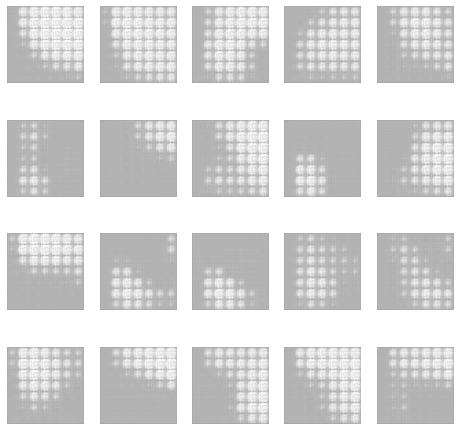

In [ ]:
loss_G_Normal, loss_D_Normal = [], []
train(normal_tensor, DAGAN_NORMAL_PATH, EPOCHS_GAN, loss_G_Normal, loss_D_Normal)

Curva Loss para Generador y Discriminador en imágenes de categoría Normal

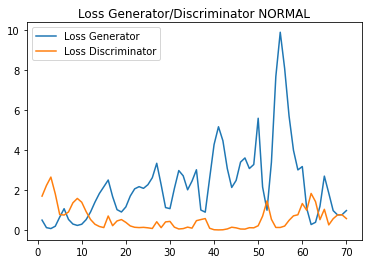

In [ ]:
plt.plot(range(1, EPOCHS_GAN+1), loss_G_Normal)
plt.plot(range(1, EPOCHS_GAN+1), loss_D_Normal)
plt.title('Loss Generator/Discriminator NORMAL')
plt.legend(['Loss Generator', 'Loss Discriminator'])

Entrenamiento para imagenes de categoría Benigno

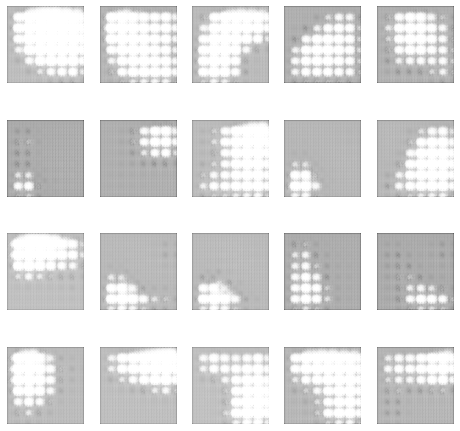

In [ ]:
loss_G_Benign, loss_D_Benign = [], []
train(benign_tensor, DAGAN_BENIGN_PATH, EPOCHS_GAN, loss_G_Benign, loss_D_Benign)

Curva Loss para Generador y Discriminador en imágenes de categoría Benigno

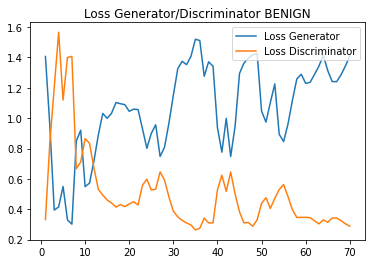

In [ ]:
plt.plot(range(1, EPOCHS_GAN+1), loss_G_Benign)
plt.plot(range(1, EPOCHS_GAN+1), loss_D_Benign)
plt.title('Loss Generator/Discriminator BENIGN')
plt.legend(['Loss Generator', 'Loss Discriminator'])

Entrenamiento para imagenes de categoría Maligno




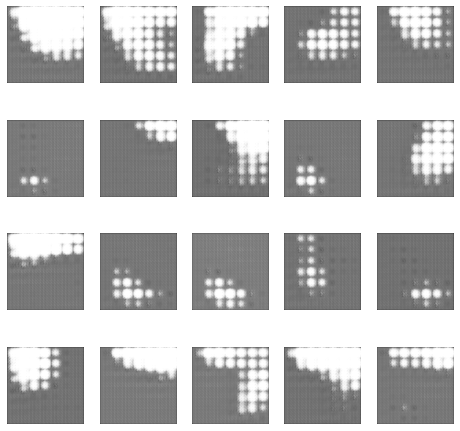

In [ ]:
loss_G_Malignant, loss_D_Malignant = [], []
train(malignant_tensor, DAGAN_MALIGNANT_PATH, EPOCHS_GAN, loss_G_Malignant, loss_D_Malignant)

Curva Loss para Generador y Discriminador en imágenes de categoría Maligno


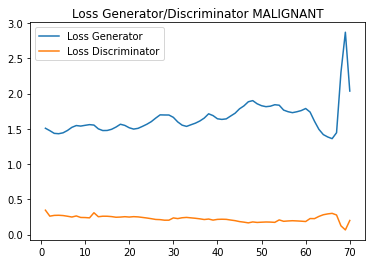

In [ ]:
plt.plot(range(1, EPOCHS_GAN+1), loss_G_Malignant)
plt.plot(range(1, EPOCHS_GAN+1), loss_D_Malignant)
plt.title('Loss Generator/Discriminator MALIGNANT')
plt.legend(['Loss Generator', 'Loss Discriminator'])

#### Gif

In [ ]:
# Display a single image using the epoch number
def display_image(epoch_no):
  return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))

In [ ]:
GIF_PATH = 'dcgan.gif'

with imageio.get_writer(GIF_PATH, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


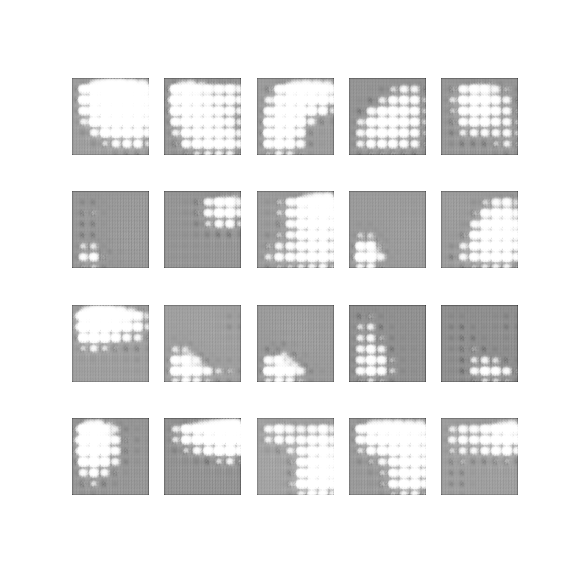

In [ ]:
embed.embed_file(GIF_PATH)

## Creacion de la red neuronal

Model Subclassing para la creación de la red neuronal

In [ ]:
class Breast_model(keras.Model):
    
    def __init__(self, num_classes = 3):
        super().__init__()
        # Preprocessing
        self.resize=layers.experimental.preprocessing.Resizing(160, 190, interpolation='lanczos3')
        self.rescaling = layers.experimental.preprocessing.Rescaling(1/255)        
        self.normalization = layers.experimental.preprocessing.Normalization()
        
        # CNN
        self.conv_1 = layers.Conv2D(32, strides=4, kernel_size=(3,3), padding='same', activation='relu', input_shape=INPUT_SHAPE)
        self.pool_1 = layers.MaxPooling2D(pool_size=(3,3), padding='same', strides=2)
        self.conv_2 = layers.Conv2D(64, kernel_size=(3,3), padding='same', activation='relu')
        self.pool_2 = layers.MaxPooling2D(pool_size=(3,3), strides=2, padding='same')
        self.conv_3 = layers.Conv2D(64, kernel_size=(3,3), padding='same', activation='relu')
        self.conv_4 = layers.Conv2D(64, kernel_size=(3,3), padding='same', activation='relu')
        self.pool_4 = layers.MaxPooling2D(pool_size=(3,3), strides=2, padding='same')
        self.flatten = layers.Flatten()       
        
        # FC
        self.dense_1 = layers.Dense(512, activation='relu')
        self.dropout_1 = layers.Dropout(0.6)
        self.dense_output = layers.Dense(num_classes, activation='softmax')
    
    def call(self, input):
        x = self.resize(input)
        x = self.rescaling(x)
        x = self.normalization(x)
        x = self.conv_1(input)
        x = self.pool_1(x)
        x = self.conv_2(x)
        x = self.pool_2(x)
        x = self.conv_3(x)
        x = self.conv_4(x)
        x = self.pool_4(x)
        x = self.flatten(x)        
        x = self.dense_1(x)
        x = self.dropout_1(x)
        return self.dense_output(x)
    
    def model(self):
        x = keras.Input(shape=INPUT_SHAPE)
        return keras.Model(inputs=[x], outputs=self.call(x))

In [ ]:
model = Breast_model()

In [ ]:
model.compile(optimizer=keras.optimizers.Adam(LEARNING_RATE), 
              loss=keras.losses.SparseCategoricalCrossentropy(), 
              metrics=[keras.metrics.SparseCategoricalAccuracy(name='acc')])

In [ ]:
model.model().summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 224, 224, 1)]     0         
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 56, 56, 32)        320       
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 28, 28, 32)        0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 28, 28, 64)        18496     
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 14, 14, 64)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 14, 14, 64)        36928     
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 14, 14, 64)        3692

Visualizando red neuronal:

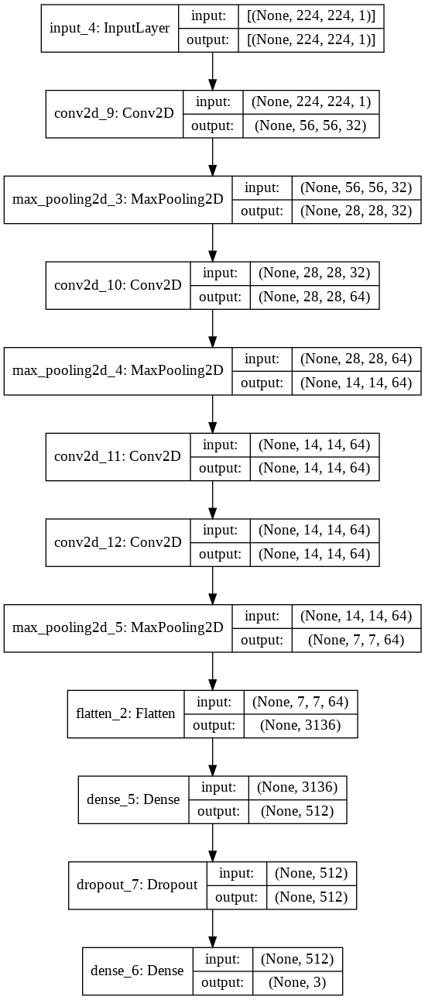

In [ ]:
plot_model(model.model(), to_file='model.png', show_shapes=True, expand_nested=True)

## Entrenamiento

Dahsboard de entrenamiento:

In [ ]:
#El comando borra el directorio de logs generado por TensorBoard, para no consurmir espacio en almacenamiento
!rm -rf "./tb_logs/"

In [ ]:
tensorboard_callback = TensorBoard(log_dir='tb_logs', histogram_freq=1, write_graph=True, write_images=True)

In [ ]:
# Cargando extensión de TensorBoard para el notebook
%load_ext tensorboard

# Visualización del TensorBoard en real-time
%tensorboard --logdir tb_logs

<IPython.core.display.Javascript object>

In [ ]:
model.fit(a, validation_data=test_img, epochs=EPOCHS, batch_size=1, 
          verbose=2, callbacks=[tensorboard_callback], 
        )

Epoch 1/25
23/23 - 30s - loss: 8.6631 - acc: 0.4309 - val_loss: 1.7530 - val_acc: 0.6167
Epoch 2/25


KeyboardInterrupt: ignored

In [ ]:
# Visualización del dashboard de Tensorboard una vez entrenado el modelo. Descomentar para desplegar TensorBoard
# notebook.display(port=6006, height=1000)

## Validación

In [ ]:
model.evaluate(test_img, verbose=2)

3/3 - 1s - loss: 0.6737 - acc: 0.7949


[0.6737391948699951, 0.7948718070983887]

## Despliegue